## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images. - COMPELTED
* Apply a distortion correction to raw images. - COMPLETED
* Use color transforms, gradients, etc., to create a thresholded binary image. - COMPLETED
* Apply a perspective transform to rectify binary image ("birds-eye view"). - COMPELTED
* Detect lane pixels and fit to find the lane boundary. - COMPLETED
* Determine the curvature of the lane and vehicle position with respect to center. - COMPLETED
* Warp the detected lane boundaries back onto the original image. - COMPELTED
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position. - COMPLETED

Developed by:  Raymond Leung
Date: 2017-05-29

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

# obtain the matrix, mtx, and distortion coefficient, dist, value
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

## Apply a distortion correction to raw images

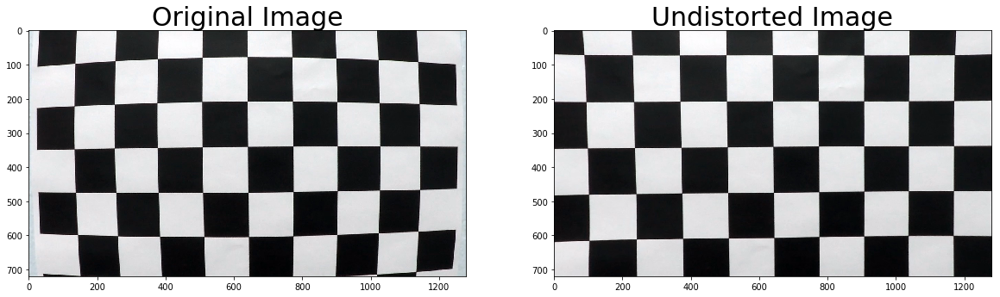

In [2]:
img = cv2.imread('camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

dst = cv2.undistort(img, mtx, dist, None, mtx)
#cv2.imwrite('./output_images/distorted_corrected_calibration1.jpg', dst)

import pickle
%matplotlib inline

# save the mtx and dist value in dist_pickle array for alter use.
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist

# displace the original and undistored version of the same image
f, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize = 30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize = 30)

## Continue to apply a distortion on a road image

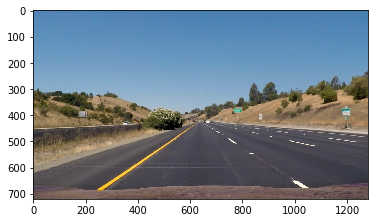

In [3]:
# get the test_image
import matplotlib.image as mpimg
%matplotlib inline

# Use cv2 to read image instead of matplotlib
#test_image = cv2.imread('./test_images/straight_lines1.jpg')
#test_image_rgb = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
#plt.imshow(test_image_rgb)                  

# User matplotlib to read an image
test_image = mpimg.imread('./test_images/straight_lines1.jpg')
plt.imshow(test_image)


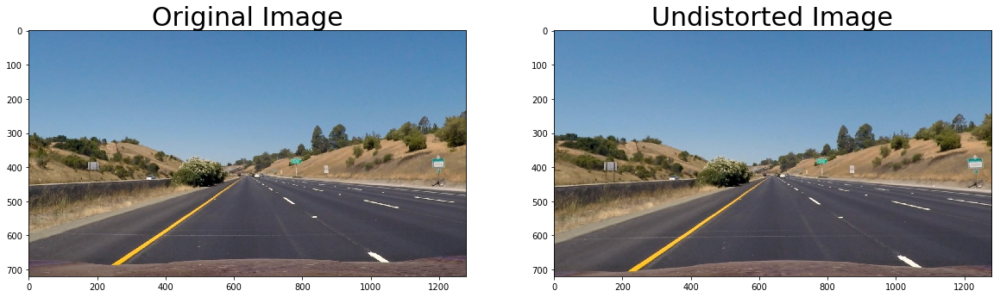

In [4]:
undist_test_image = cv2.undistort(test_image, mtx, dist, None, mtx)
#cv2.imwrite('./output_images/undistorted_straight_line1.jpg', undist_test_image)

f, (ax1, ax2) = plt.subplots(1,2, figsize=(20,10))
ax1.imshow(test_image)
ax1.set_title('Original Image', fontsize = 30)
ax2.imshow(undist_test_image)
ax2.set_title('Undistorted Image', fontsize = 30)

In [5]:
# switch to regular plot windows
# use the interactive navigration to see the coordinate of the straight line
# use the informatin for the warper function
# since we know the test image represent a straight line, we can draw a retangle based on it

#%matplotlib qt

#plt.imshow(undist_test_image)

## Use color transforms, gradients etc., to create a threshold binary image

### Gradienet Threshold with Sobel Operator

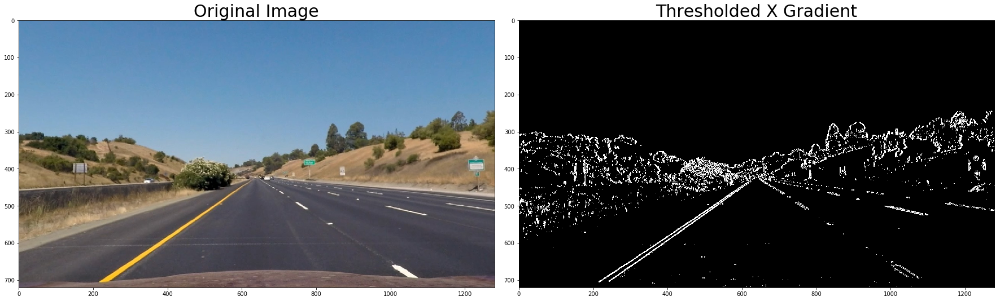

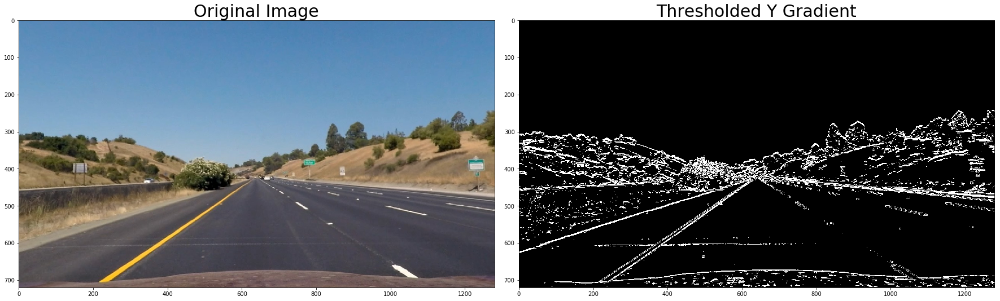

In [6]:
# gradient threshold
# Define a function that applies Sobel x or y, 
# then takes an absolute value and applies a threshold.
# Note: calling your function with orient='x', thresh_min=5, thresh_max=100
# should produce output like the example image shown above this quiz.

%matplotlib inline
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0,255)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    # 3) Take the absolute value of the derivative or gradient
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    # 6) Return this mask as your binary_output image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    #test l channel gray = l_channel for without changing code
    # comment out since it make not much different
    #hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    #l_channel = hsv[:,:,1]
    #gray = l_channel
    
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    if orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    abs_sobel = np.absolute(sobel)
    scale_sobel = np.uint8(255 * abs_sobel / np.max(abs_sobel))
    binary_output = np.zeros_like(scale_sobel)
    binary_output[(scale_sobel >= thresh[0]) & (scale_sobel <= thresh[1])] = 1
    return binary_output

# Run the gradient binary for absolute sobel
gradx_binary = abs_sobel_thresh(undist_test_image, orient='x', thresh=(20, 100))
grady_binary = abs_sobel_thresh(undist_test_image, orient='y', thresh=(20, 100))

#cv2.imwrite('./output_images/sobelx_thresh.jpg', gradx_binary)
#cv2.imwrite('./output_images/sobely_thresh.jpg', grady_binary)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist_test_image)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(gradx_binary, cmap='gray')
ax2.set_title('Thresholded X Gradient', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist_test_image)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(grady_binary, cmap='gray')
ax2.set_title('Thresholded Y Gradient', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Magnitude of the gradient

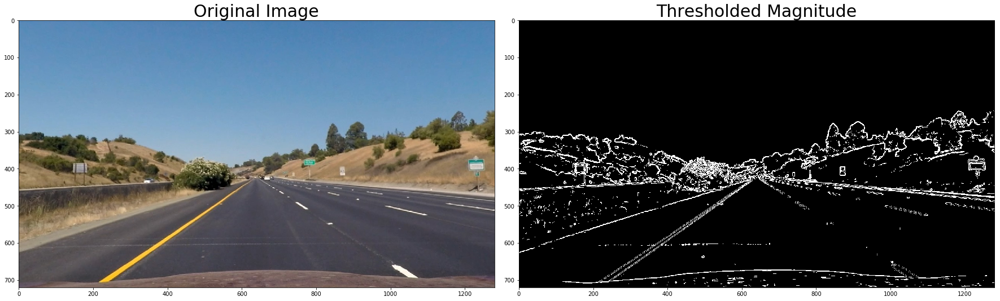

In [7]:
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    # 2) Take the gradient in x and y separately
    # 3) Calculate the magnitude 
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    # 5) Create a binary mask where mag thresholds are met
    # 6) Return this mask as your binary_output image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    scale_factor = np.max(gradmag)/255
    gradmag = (gradmag/scale_factor).astype(np.uint8)
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    return binary_output
    
# Run the function
mag_binary = mag_thresh(undist_test_image, sobel_kernel=3, mag_thresh=(30, 100))
#cv2.imwrite('./output_images/magnitude_thresh.jpg', mag_binary)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist_test_image)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Thresholded Magnitude', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Direction of the gradient

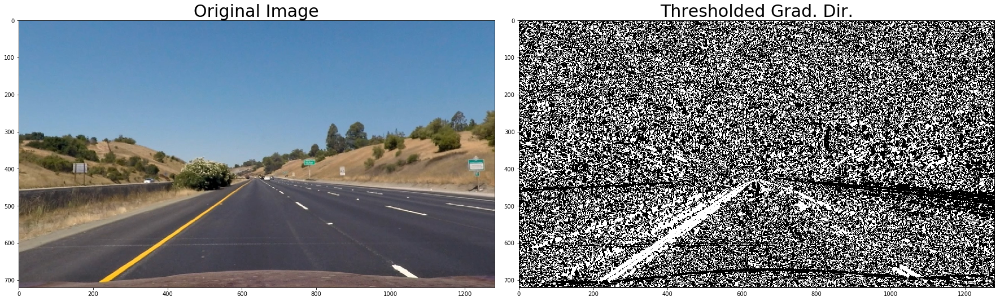

In [8]:
# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    # 2) Take the gradient in x and y separately
    # 3) Take the absolute value of the x and y gradients
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    # 5) Create a binary mask where direction thresholds are met
    # 6) Return this mask as your binary_output image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output = np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    return binary_output
    
# Run the function
dir_binary = dir_threshold(undist_test_image, sobel_kernel=15, thresh=(0.7, 1.3))
#cv2.imwrite('./output_images/direction_thresh.jpg', dir_binary)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist_test_image)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Combine threshold

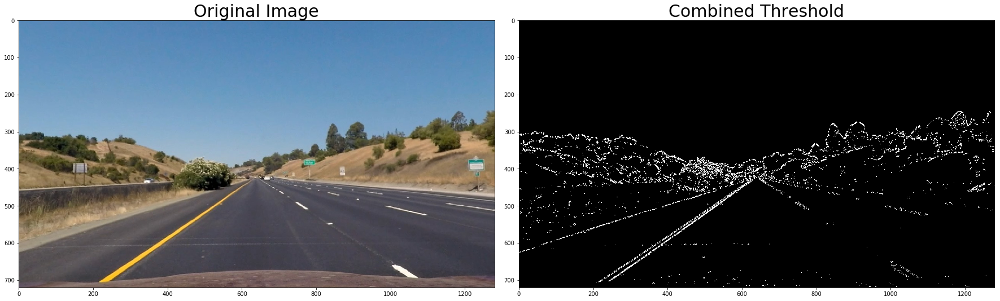

In [9]:
def combined_threshold(gradx_binary, grady_binary, mag_binary, dir_binary):
    binary_output = np.zeros_like(dir_binary)
    binary_output[((gradx_binary == 1) & (grady_binary == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    return binary_output

ksize = 3

gradx_binary = abs_sobel_thresh(undist_test_image, orient='x', sobel_kernel=ksize, thresh=(20,100))
grady_binary = abs_sobel_thresh(undist_test_image, orient='y', sobel_kernel=ksize, thresh=(20,100))
mag_binary = mag_thresh(undist_test_image, sobel_kernel=ksize, mag_thresh=(30, 100))
dir_binary = dir_threshold(undist_test_image, sobel_kernel=ksize, thresh=(0.7, 1.3))

combined_binary = combined_threshold(gradx_binary, grady_binary, mag_binary, dir_binary)
#cv2.imwrite('./output_images/combined_thresh.jpg', combined_binary)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist_test_image)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(combined_binary, cmap='gray')
ax2.set_title('Combined Threshold', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


### HLS and S-Channel Color Threshold

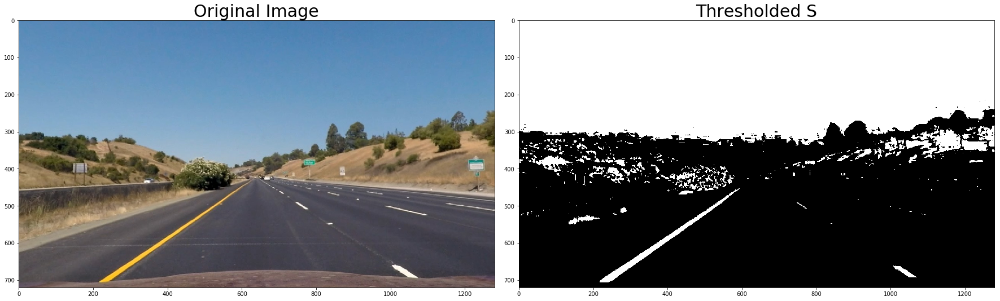

In [10]:
def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    # 2) Apply a threshold to the S channel
    # 3) Return a binary image of threshold result
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    binary_output = np.zeros_like(S)
    binary_output[(S > thresh[0]) & (S <= thresh[1])] = 1
    return binary_output
    
hls_binary = hls_select(undist_test_image, thresh=(90, 255))
#cv2.imwrite('./output_images/s-channnel.jpg', hls_binary)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist_test_image)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(hls_binary, cmap='gray')
ax2.set_title('Thresholded S', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### Color S=Channel and Combined Gradient

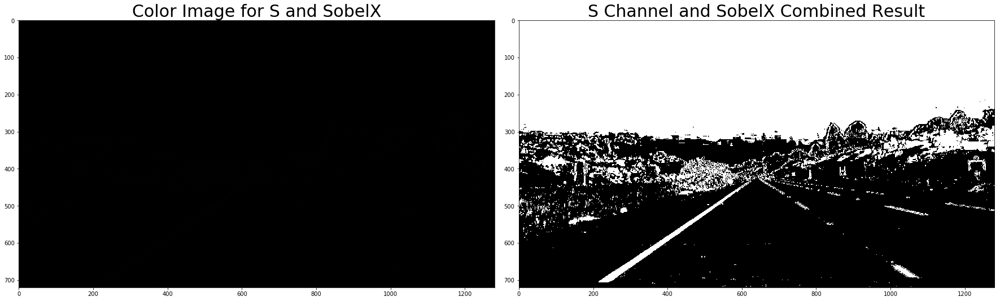

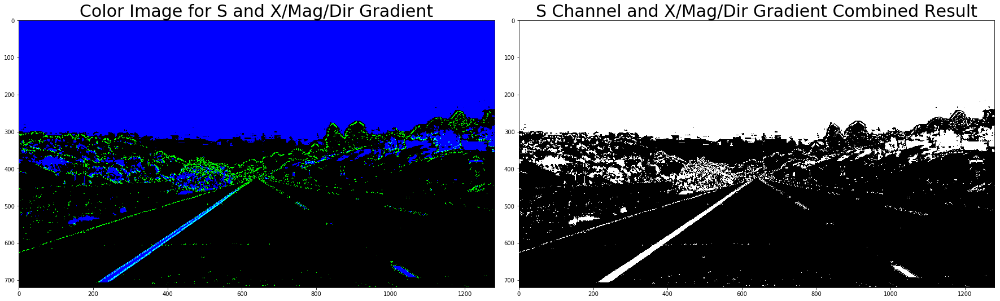

In [11]:
# Stack each channel
# Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
# be beneficial to replace this channel with something else.


def color_and_gradient(hls_binary, any_gradient_binary):   
    binary_output = np.zeros_like(any_gradient_binary)
    binary_output[(hls_binary == 1) | (any_gradient_binary == 1)] = 1
    return binary_output

color_s_gradx_binary = np.dstack(( np.zeros_like(gradx_binary), gradx_binary, hls_binary))
color_s_combined_grad_binary = np.dstack(( np.zeros_like(combined_binary), combined_binary, hls_binary))
s_gradx_binary = color_and_gradient(hls_binary, gradx_binary)
s_combined_grad_binary = color_and_gradient(hls_binary, combined_binary)
#cv2.imwrite('./output_images/s-sobelx.jpg', s_gradx_binary)
#cv2.imwrite('./output_images/s-combined.jpg', s_combined_grad_binary)


# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(color_s_gradx_binary)
ax1.set_title('Color Image for S and SobelX', fontsize=30)
ax2.imshow(s_gradx_binary, cmap='gray')
ax2.set_title('S Channel and SobelX Combined Result', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(color_s_combined_grad_binary)
ax1.set_title('Color Image for S and X/Mag/Dir Gradient', fontsize=30)
ax2.imshow(s_combined_grad_binary, cmap='gray')
ax2.set_title('S Channel and X/Mag/Dir Gradient Combined Result', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


## Apply a perspective transform to rectify binary image ("birds-eye view").

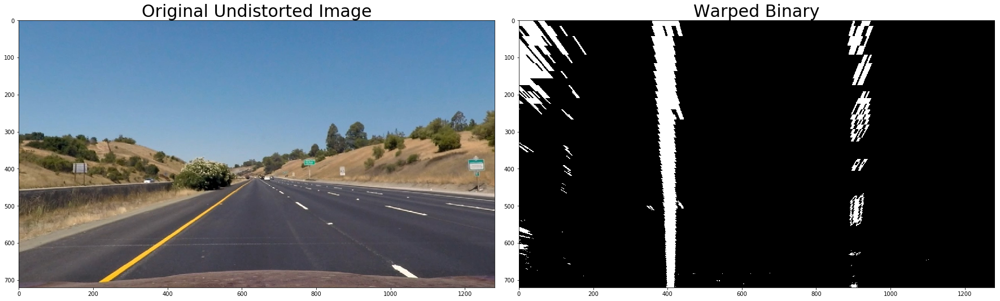

In [12]:
# define a 
def warper(img):

    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    
    # Use the actual mesaure on the straight line image to get the following number
    #src = np.float32([[599,450],[258,685],[1051,685],[681,450]])
    #dst = np.float32([[258,0], [258, 720], [1051,720],[1051,0]])
    
    # It is a better format for photo in differnet resolution
    # [599,450] = width x 0.4680, height x 0.625     
    # [258, 685] = width x 0.2016, height x 0.9514    
    # [1051, 685] = width x 0.8211, height x 0.9514    
    # [681, 450] = width x 0.5320, height x 0.625
    w = img.shape[1]
    h = img.shape[0]
    offset = 150
    src = np.float32([[w*0.4680, h*0.6250],[w*0.2016,h*0.9514],[w*0.8211,h*0.9514],[w*0.5320,h*0.625]])
    dst = np.float32([[w*0.2016 + offset,0], [w*0.2016 + offset, img.shape[0]], [w*0.8211 - offset,img.shape[0]],[w*0.8211 - offset,0]])
    
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image

    return warped


warper_binary = warper(s_gradx_binary)
#cv2.imwrite('./output_images/warper_straight_line1.jpg', warper_binary)

%matplotlib inline

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist_test_image)
ax1.set_title('Original Undistorted Image', fontsize=30)
ax2.imshow(warper_binary, cmap='gray')
ax2.set_title('Warped Binary', fontsize=30)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

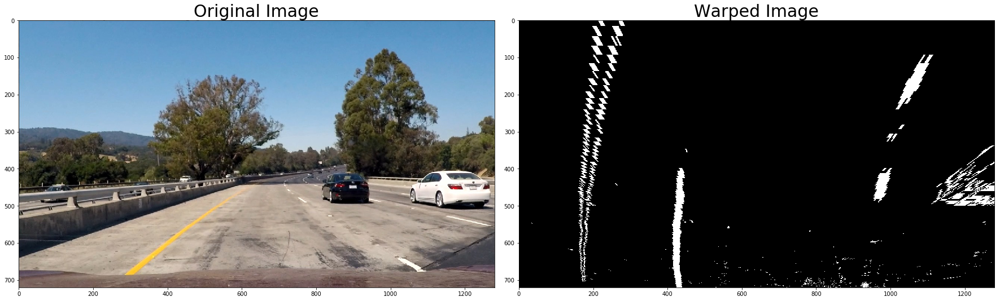

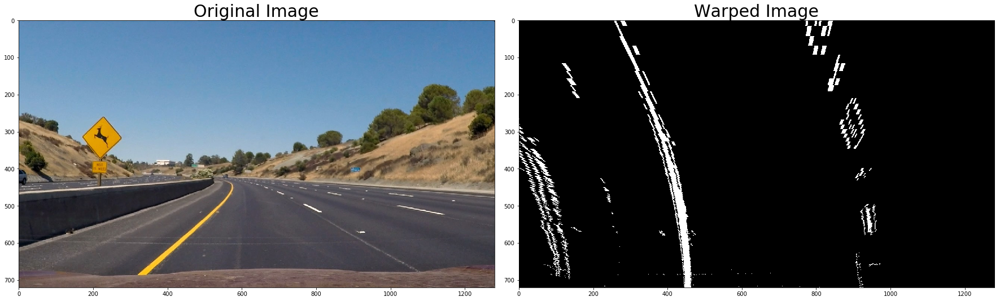

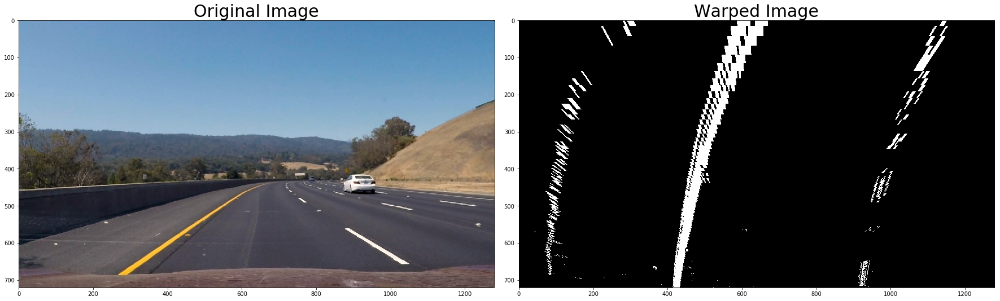

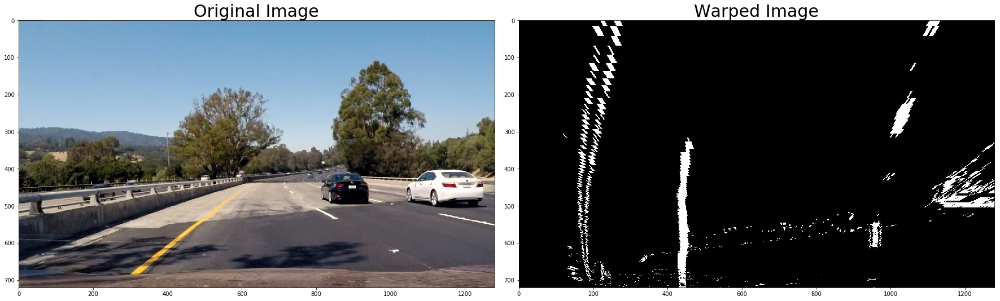

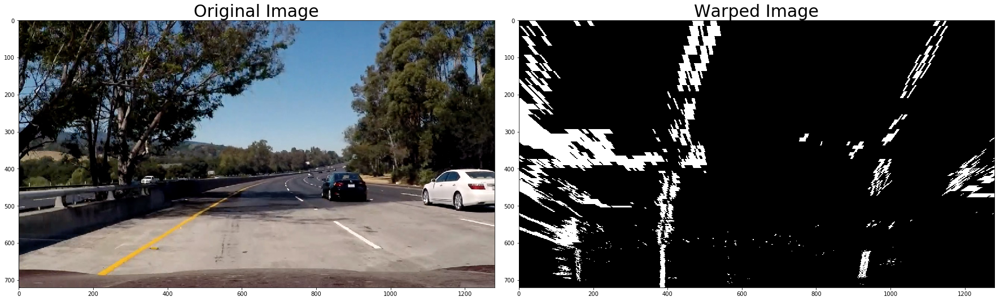

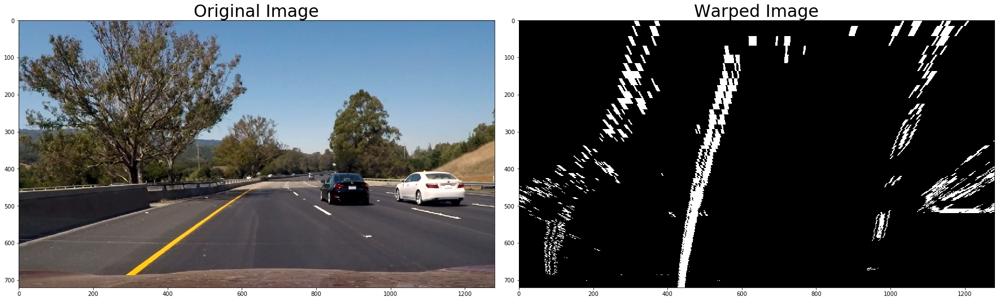

In [13]:
# build a quick pipe

def original_to_warper(image, mtx, dist):
    ksize=3
    undist_image = cv2.undistort(image, mtx, dist, None, mtx)
    gradx_binary = abs_sobel_thresh(undist_image, orient='x', sobel_kernel=ksize, thresh=(20, 100))
    grady_binary = abs_sobel_thresh(undist_image, orient='y', sobel_kernel=ksize, thresh=(20,100))
    mag_binary = mag_thresh(undist_image, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary = dir_threshold(undist_image, sobel_kernel=ksize, thresh=(0.7, 1.3))
    combined_binary = combined_threshold(gradx_binary, grady_binary, mag_binary, dir_binary)   
    hls_binary = hls_select(undist_image, thresh=(170, 255))
    #s_gradx_binary = color_and_gradient(hls_binary, gradx_binary)
    s_combined_grad_binary = color_and_gradient(hls_binary, combined_binary)
    #output_binary = s_gradx_binary
    output_binary = warper(s_combined_grad_binary)
    return output_binary, undist_image

# Make a list of test images
test_images = glob.glob('./test_images/test*.jpg')

# Step through the list and search for chessboard corners
for test_fname in test_images:
    testdir_image = mpimg.imread(test_fname)
    output_binary, undist_image = original_to_warper(testdir_image, mtx, dist)
    #cv2.imwrite('./output_images/warped_binary_' + test_fname.split('/')[-1], output_binary)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(testdir_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(output_binary, cmap='gray')  
    ax2.set_title('Warped Image', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

## Detect lane pixels and fit to find the lane boundary.

(720, 0)

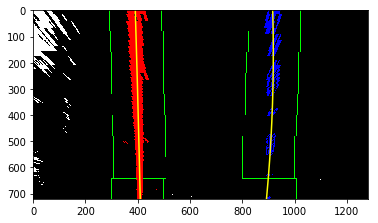

In [14]:
import numpy as np
import cv2
import matplotlib.pyplot as plt


# manual refactor warper binary name to avoid getting syntax area.  
binary_warped = warper_binary

def detect_lane(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    #plt.imshow(out_img)
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
    #plt.xlim(0, 1280)
    #plt.ylim(720, 0)

    return out_img, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx

out_img, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx = detect_lane(warper_binary)

plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)


(720, 0)

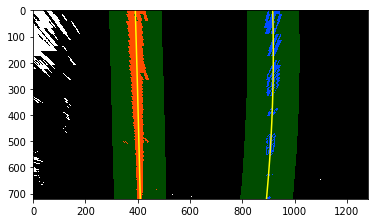

In [15]:
def detect_lane_next(binary_warped, left_fit, right_fit):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    return result, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx
    

result, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx = detect_lane_next(binary_warped, left_fit, right_fit)    

plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

In [16]:
# a pipeline to return a filled lane with original image
def origin_to_found_lane(image, mtx, dist):
    binary_warped, undist_image = original_to_warper(image, mtx, dist)
    out_img, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx = detect_lane(binary_warped)
    result, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx = detect_lane_next(binary_warped, left_fit, right_fit)
    return result, undist_image    

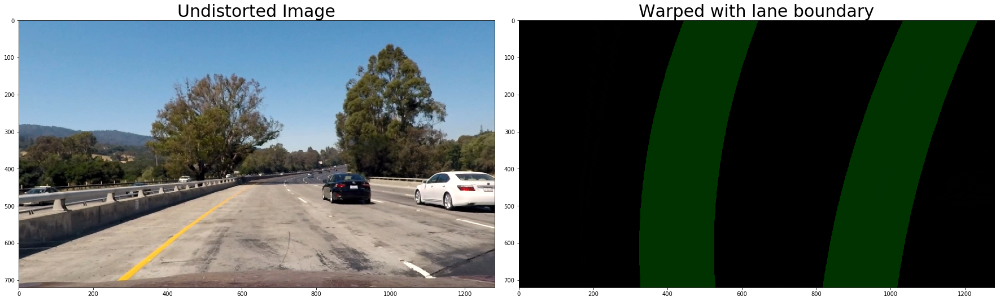

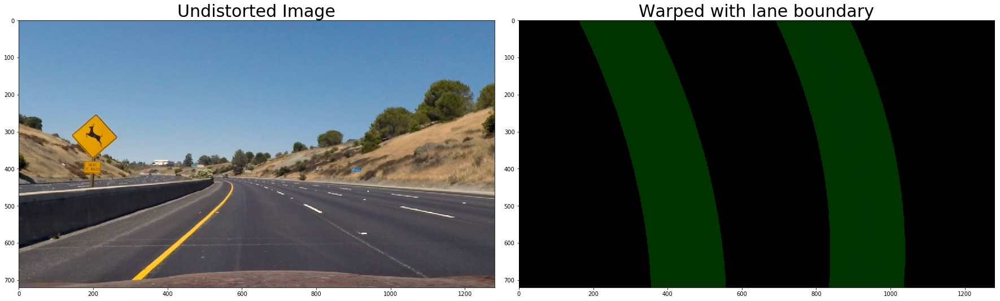

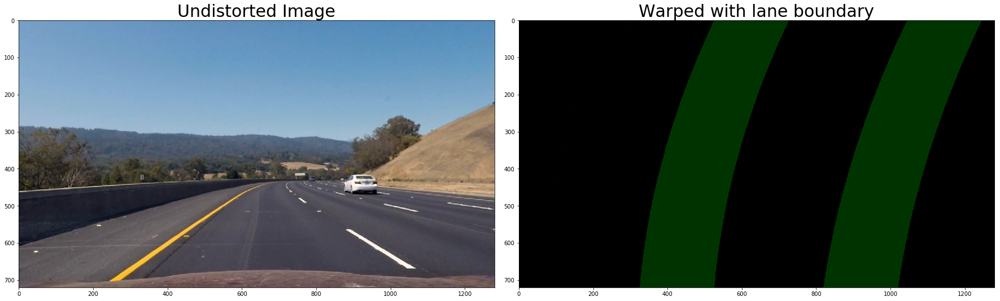

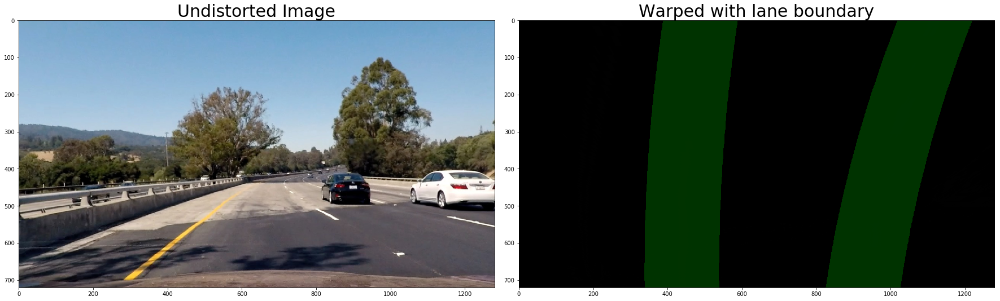

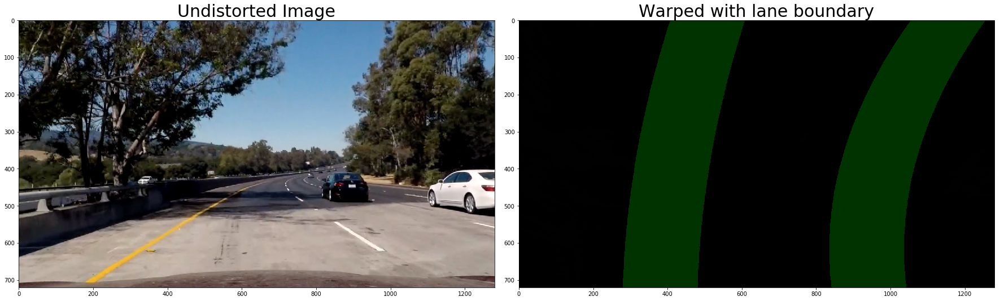

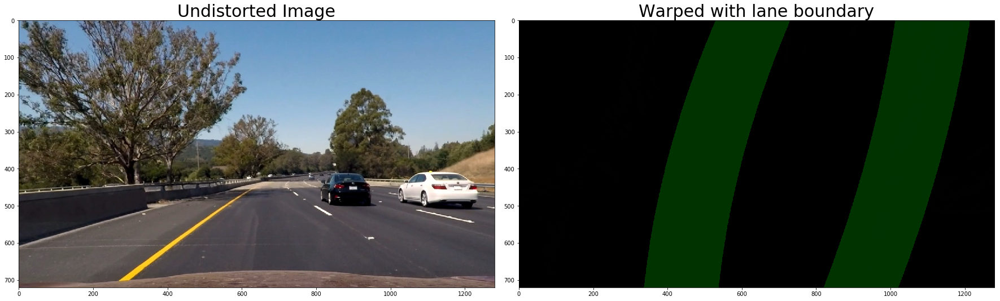

In [17]:
# Make a list of test images
test_images = glob.glob('./test_images/test*.jpg')

# Step through the list and search for chessboard corners
for test_fname in test_images:
    testdir_image = mpimg.imread(test_fname)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    found_lane_image, undist_image = origin_to_found_lane(testdir_image, mtx, dist)
    ax1.imshow(undist_image)
    ax1.set_title('Undistorted Image', fontsize=30)
    ax2.imshow(found_lane_image, cmap='gray')
    ax2.set_title('Warped with lane boundary', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
  

## Warp the detected lane boundaries back onto the original image.

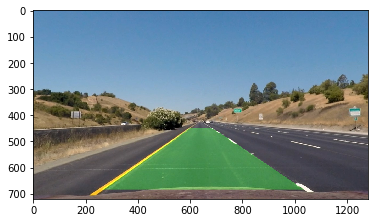

In [18]:
def fill_lane(binary_warped, undist_image, left_fitx, right_fitx, ploty):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # recalculate the Minv 
    # Use the actual mesaure on the straight line image to get the following number
    #src = np.float32([[599,450],[258,685],[1051,685],[681,450]])
    #dst = np.float32([[258,0], [258, 720], [1051,720],[1051,0]])
    
    # It is a better format for photo in differnet resolution
    # [599,450] = width x 0.4680, height x 0.625     
    # [258, 685] = width x 0.2016, height x 0.9514    
    # [1051, 685] = width x 0.8211, height x 0.9514    
    # [681, 450] = width x 0.5320, height x 0.625
    w = binary_warped.shape[1]
    h = binary_warped.shape[0]
    offset = 150
    src = np.float32([[w*0.4680, h*0.6250],[w*0.2016,h*0.9514],[w*0.8211,h*0.9514],[w*0.5320,h*0.625]])
    dst = np.float32([[w*0.2016 + offset,0], [w*0.2016 + offset, img.shape[0]], [w*0.8211 - offset,img.shape[0]],[w*0.8211 - offset,0]])

    Minv = cv2.getPerspectiveTransform(dst, src)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (binary_warped.shape[1], binary_warped.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist_image, 1, newwarp, 0.3, 0)
    return result

fill_lane_image = fill_lane(binary_warped, undist_test_image, left_fitx, right_fitx, ploty)
plt.imshow(fill_lane_image)

In [19]:
#### Build a pipe line to return filled lane

In [20]:
# a pipeline to return a filled lane with original image
def origin_to_fill_undist(image, mtx, dist):
    binary_warped, undist_image = original_to_warper(image, mtx, dist)
    out_img, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx = detect_lane(binary_warped)
    result, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx = detect_lane_next(binary_warped, left_fit, right_fit)
    fill_lane_image = fill_lane(binary_warped, undist_image, left_fitx, right_fitx, ploty)
    #return result, undist_image    
    return fill_lane_image, undist_image

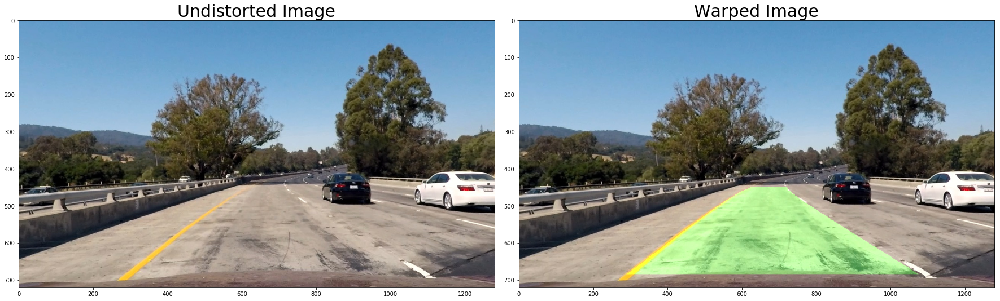

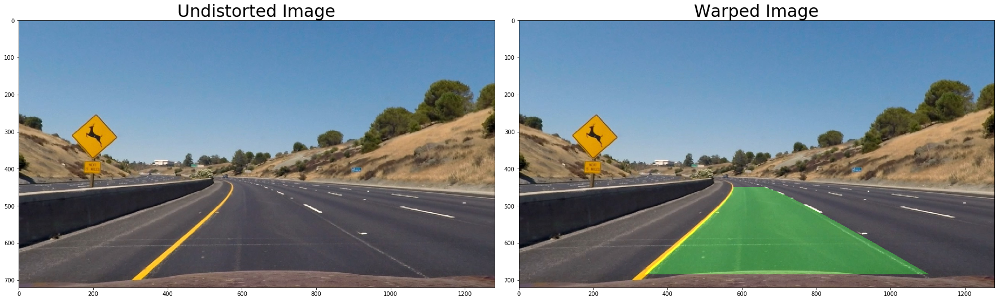

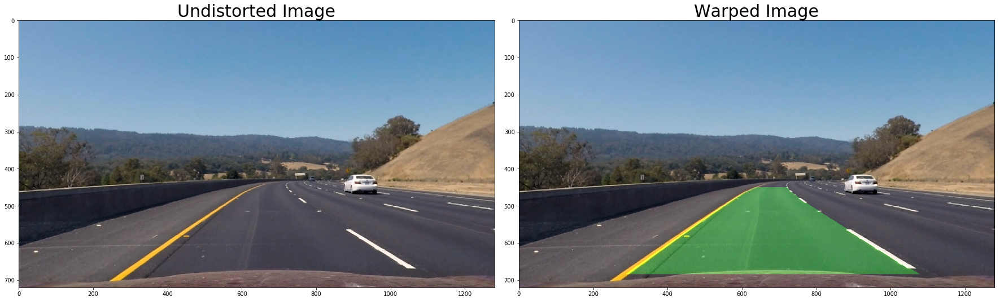

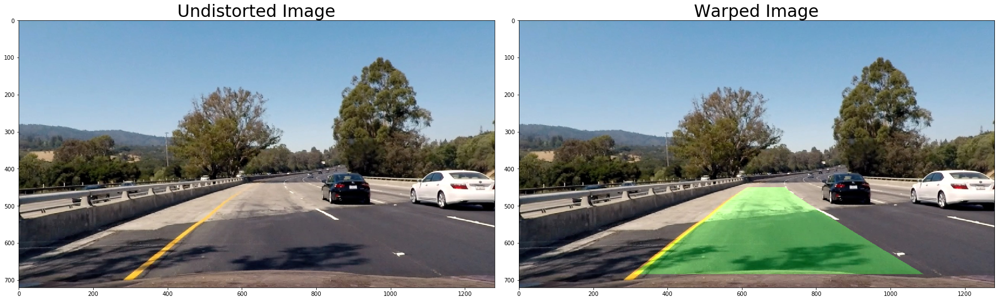

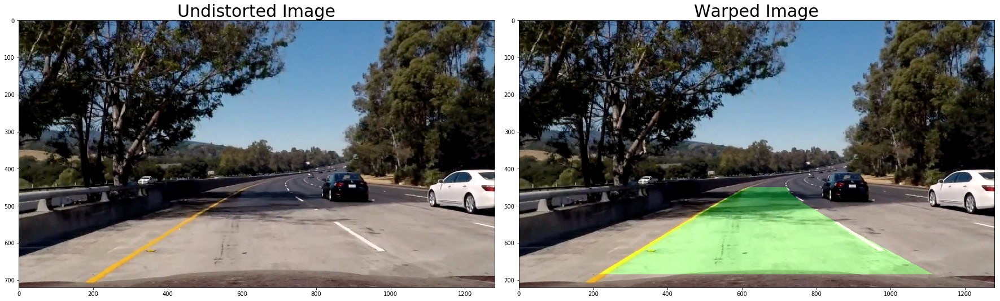

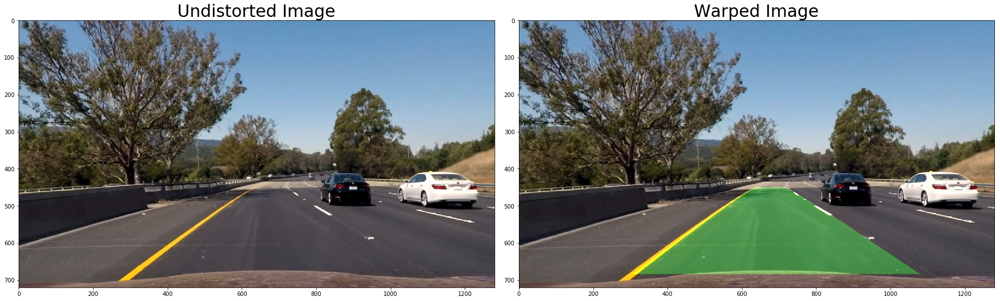

In [21]:
# Make a list of test images
test_images = glob.glob('./test_images/test*.jpg')

# Step through the list and search for chessboard corners
for test_fname in test_images:
    testdir_image = mpimg.imread(test_fname)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    fill_lane_image, undist_image = origin_to_fill_undist(testdir_image, mtx, dist)
    ax1.imshow(undist_image)
    ax1.set_title('Undistorted Image', fontsize=30)
    ax2.imshow(fill_lane_image, cmap='gray')
    ax2.set_title('Warped Image', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
  

## Determine the curvature of the lane and vehicle position with respect to center.

In [22]:
import numpy as np
import matplotlib.pyplot as plt

In [23]:
# This is the for the exercise for the fake data, we don't need to do this since I get the rightx, leftx data 
# from previous cell

# Generate some fake data to represent lane-line pixels
def generate_fake_image():
    ploty = np.linspace(0, 719, num=720)# to cover same y-range as image
    quadratic_coeff = 3e-4 # arbitrary quadratic coefficient

    # For each y position generate random x position within +/-50 pix
    # of the line base position in each case (x=200 for left, and x=900 for right)

    leftx = np.array([200 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51)       
                                  for y in ploty])
    rightx = np.array([900 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                  for y in ploty])

    leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
    rightx = rightx[::-1]  # Reverse to match top-to-bottom in y


    # Fit a second order polynomial to pixel positions in each fake lane line

    left_fit = np.polyfit(ploty, leftx, 2)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fit = np.polyfit(ploty, rightx, 2)
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Plot up the fake data
    
    
    mark_size = 3
    plt.plot(leftx, ploty, 'o', color='red', markersize=mark_size)
    plt.plot(rightx, ploty, 'o', color='blue', markersize=mark_size)
    plt.xlim(0, 1280)
    plt.ylim(0, 720)
    plt.plot(left_fitx, ploty, color='green', linewidth=3)
    plt.plot(right_fitx, ploty, color='green', linewidth=3)
    plt.gca().invert_yaxis() # to visualize as we do the images
    
    return 0

# No need to do this one, just try out the sample from the lesson
#generate_fake_image()


### Calculate the radius of curvature

In [45]:
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

def get_radius_of_curvature_in_meter(ploty, left_fitx, right_fitx):
    y_eval = np.max(ploty)
    # calculated based on radius of curvature.  In this project, we want to put in meter
    #left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    #right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    #print(left_curverad, right_curverad)

    # Define conversions in x and y from pixels space to meters
    # Move to global later on, since it will be reused in other function
    #ym_per_pix = 30/720 # meters per pixel in y dimension
    #xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    #print(left_curverad, 'm', right_curverad, 'm')
    # Example values: 632.1 m    626.2 m
    return left_curverad, right_curverad

# use the straight line image as a example, since it is a pure straight, the curvature will be infinity
print(get_radius_of_curvature_in_meter(ploty, left_fitx, right_fitx))        

(32724.608585580394, 1938.553458955128)


In [47]:
# get the idea from the homework video
def offset_on_road(image, left_fitx, right_fitx):
    camera_center = (left_fitx[-1] + right_fitx[-1]) / 2
    #print(camera_center)
    # Turn out the image camera center is more toward the left, - 42
    # center_diff = (camera_center - image.shape[1]/2 - 42) * xm_per_pix
    
    center_diff = (camera_center - image.shape[1]/2) * xm_per_pix
    
    #print(image.shape[1]/2)
    #side_pos = 1
    #if center_diff <= 0:
    #    side_pos = 0
    return center_diff

#center_diff, side_pos = offset_on_road(undist_test_image, left_fit, right_fit)
center_diff = offset_on_road(undist_test_image, left_fit, right_fit)


print(center_diff)


0.071403170518


## Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [48]:
# a pipeline to return a filled lane with original image
def origin_to_fill_undist_curverad(image):
    
    binary_warped, undist_image = original_to_warper(image, mtx, dist)
    out_img, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx = detect_lane(binary_warped)
    result, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx = detect_lane_next(binary_warped, left_fit, right_fit)
    fill_lane_image = fill_lane(binary_warped, undist_image, left_fitx, right_fitx, ploty)
    left_curverad, right_curverad = get_radius_of_curvature_in_meter(ploty, left_fitx, right_fitx)
    center_diff = offset_on_road(binary_warped, left_fitx, right_fitx)
    
    curver_text = 'Curvature radius: {0} m. '.format((int(left_curverad) + int(right_curverad)) / 2 )
    dist_center_text = 'Distance from center: {0} m. '.format(( np.math.ceil(abs(center_diff) * 100) / 100)) 
    
    cv2.putText(fill_lane_image, curver_text,(25,75),cv2.FONT_HERSHEY_SIMPLEX,2,(255,255,0),2,cv2.LINE_AA)
    cv2.putText(fill_lane_image, dist_center_text, (25, 125), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 255, 0), 2, cv2.LINE_AA)
    
    
    
    return fill_lane_image 

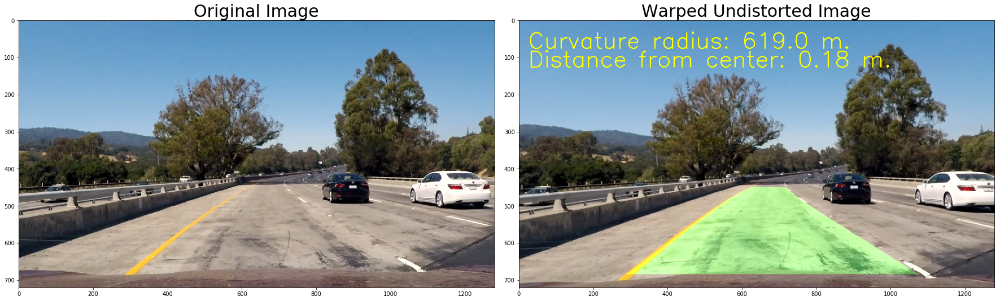

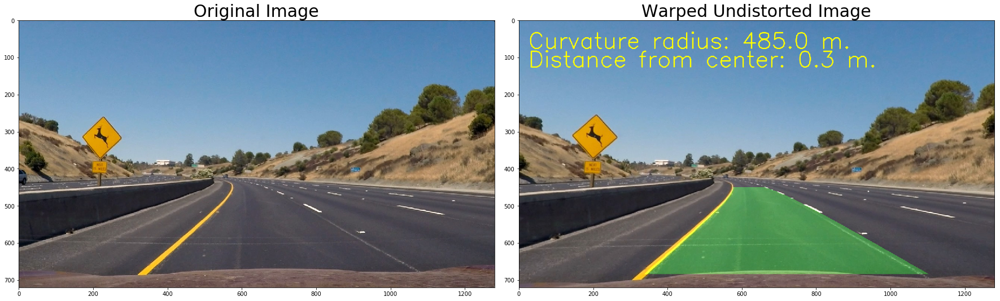

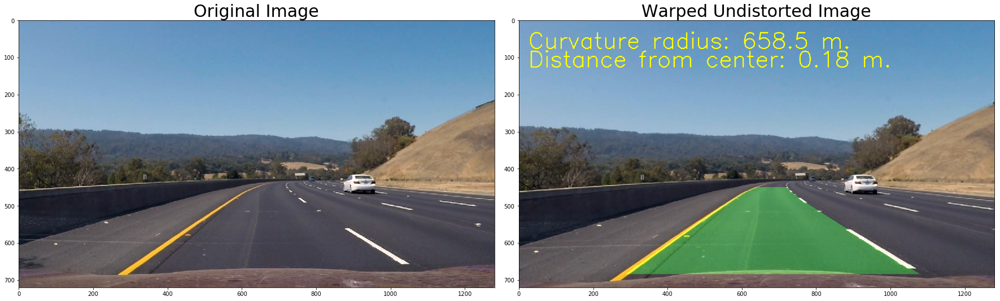

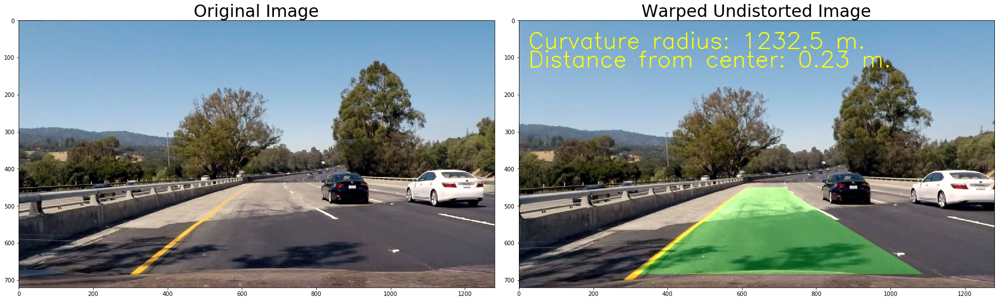

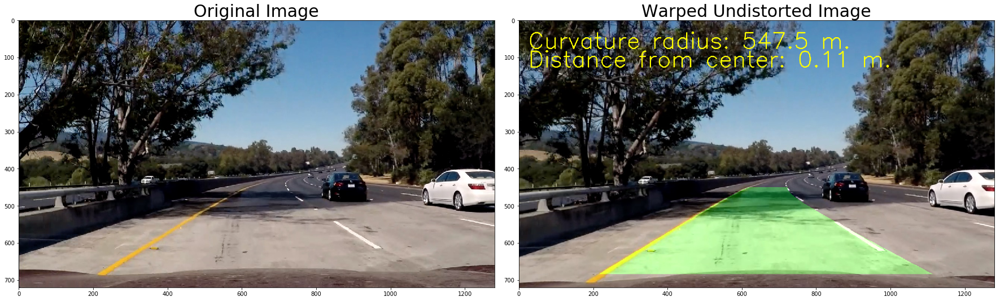

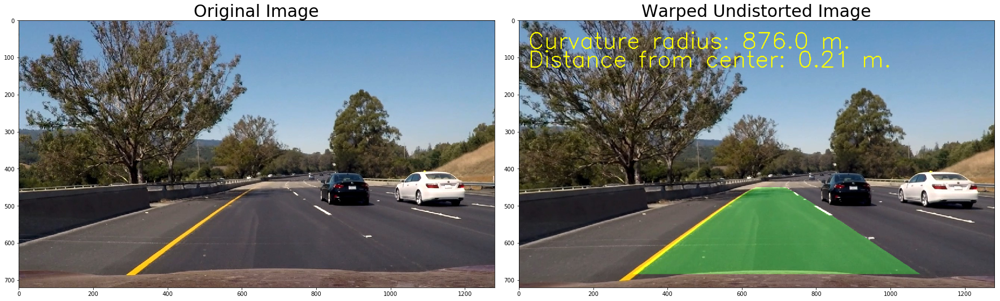

In [49]:
# Make a list of test images
test_images = glob.glob('./test_images/test*.jpg')

# Step through the list and search for chessboard corners
for test_fname in test_images:
    testdir_image = mpimg.imread(test_fname)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    fill_lane_image = origin_to_fill_undist_curverad(testdir_image)
    ax1.imshow(testdir_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(fill_lane_image, cmap='gray')
    ax2.set_title('Warped Undistorted Image', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
  

## Pipeline for the video

In [50]:
# need to add more logic for the pipeline to use the previous frame data is curvature or distance from center 
# is out of bound

# It ends up not used and too complicated to use.   I simplied to Lanes Class which only need to contains left_fitx,
# right_fitx and ploty for current state and last known state.

# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None


In [51]:
class Lanes:
        cache_current = None
        cache_last_known_good = None
        

In [54]:
def pipeline(image):
    
    binary_warped, undist_image = original_to_warper(image, mtx, dist)
    out_img, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx = detect_lane(binary_warped)
    result, left_fitx, right_fitx, ploty, left_fit, right_fit, leftx, rightx = detect_lane_next(binary_warped, left_fit, right_fit)

   
    
    left_curverad, right_curverad = get_radius_of_curvature_in_meter(ploty, left_fitx, right_fitx)
    center_diff = offset_on_road(binary_warped, left_fitx, right_fitx)    
    
    #check if left_curverad and right_curverad is < 2500, if more that 2500, it is a strightline
    # Make sure the center is not too off, when it is over is range, it detect the wrong path
    
    
    if (center_diff > 0.00 and center_diff < 0.70):
        Lanes.cache_current = [left_fitx, right_fitx, ploty]
        Lanes.last_known_good = [left_fitx, right_fitx, ploty]
    else:
        Lanes.cache_current = Lanes.last_known_good
    
    
    
    fill_lane_image = fill_lane(binary_warped, undist_image, Lanes.cache_current[0], Lanes.cache_current[1], Lanes.cache_current[2])

    curver_text = 'Curvature radius: {0} m. '.format((int(left_curverad) + int(right_curverad)) / 2 )
    dist_center_text = 'Distance from center: {0} m. '.format(( np.math.ceil(abs(center_diff) * 100) / 100))

    
    
    cv2.putText(fill_lane_image, curver_text,(25,75),cv2.FONT_HERSHEY_SIMPLEX,2,(255,255,0),2,cv2.LINE_AA)
    cv2.putText(fill_lane_image, dist_center_text, (25, 125), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 255, 0), 2, cv2.LINE_AA)
    
    
    
    return fill_lane_image 

In [55]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import imageio
imageio.plugins.ffmpeg.download()

white_output = './output_project_video.mp4'
clip1 = VideoFileClip("./project_video.mp4")
white_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video ./output_project_video.mp4
[MoviePy] Writing video ./output_project_video.mp4


100%|█████████▉| 1260/1261 [05:58<00:00,  3.21it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./output_project_video.mp4 

CPU times: user 5min 44s, sys: 1min 39s, total: 7min 24s
Wall time: 5min 59s


In [56]:
white_output = './output_harder_challenge_video.mp4'
clip1 = VideoFileClip("./harder_challenge_video.mp4")
white_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video ./output_harder_challenge_video.mp4
[MoviePy] Writing video ./output_harder_challenge_video.mp4


100%|█████████▉| 1199/1200 [06:23<00:00,  3.42it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./output_harder_challenge_video.mp4 

CPU times: user 6min 3s, sys: 1min 43s, total: 7min 46s
Wall time: 6min 24s
